In [18]:
# Load pickled data

import matplotlib.pyplot as plt
import pickle, cv2, csv, os, time
import numpy as np
from numpy import newaxis
from random import randint
import tensorflow as tf
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from matplotlib import gridspec
from skimage.transform import rescale, resize, downscale_local_mean

# Visualizations will be shown in the notebook.
%matplotlib inline

In [39]:
def return_files_from_dir(path,numfiles_to_display):
    '''
    input: path: direcory of files to return
           num_files: number of files to return from dir
    output: returns file path+name
    '''
    f = []
    for (dirpath, dirnames, filenames) in walk(path):
        f.extend(filenames)
        break
    if(os.path.isfile(path + '.DS_Store')):
        f.remove('.DS_Store')
    print('numfiles:',len(f))
    files_to_display = []
    for x in range(0,numfiles_to_display):
        index = random.randint(0,len(f))
        print('index:',index,path + f[index])
        files_to_display.append(path + f[index])

    return files_to_display


def display(data, num_rows=8, num_cols=6,debug=False):
    images = []

    for x in data:
        #print ('x:',x)
        img = cv2.imread(x)
        #print (img.shape)
        images.append(img)

    #print (images[0].shape)
    #problem w 3 rows is it makes the images smaller


    fig = plt.figure(figsize=(32,32))

    gs = gridspec.GridSpec(num_rows, num_cols, 
                       left=None, bottom=None, 
                       right=None, top=None, wspace=None, 
                       hspace=None, width_ratios=None, height_ratios=None)
    gs.update(wspace=0.025, hspace=0.05)
    if debug:
        #setting gridspec params to None shows the default values below
        print('left:',gs.get_subplot_params(fig).left)
        print('right:',gs.get_subplot_params(fig).right)
        print('top:',gs.get_subplot_params(fig).top)
        print('bottom:',gs.get_subplot_params(fig).bottom)
        print('wspace:',gs.get_subplot_params(fig).wspace)
        print('hspace:',gs.get_subplot_params(fig).hspace)
        print('height_ratios:',gs.get_height_ratios())
        print('width_ratios:',gs.get_width_ratios())
        print('grid positions:', gs.get_grid_positions(fig))
    #plt.subplots_adjust(hspace = .001)
    #plt.subplots_adjust(wspace = .001)
    
    #plt.subplots_adjust(top = .3)
    #plt.subplots_adjust(bottom = .1)
    #https://stackoverflow.com/questions/6541123/improve-subplot-size-spacing-with-many-subplots-in-matplotlib?rq=1
    #hspace controls the spacing between rows. Make sure to set it small enough

    ax = [plt.subplot(gs[i]) for i in range(num_rows*num_cols)]
    plt.subplots_adjust(wspace=0, hspace=0)
    #gs.tight_layout(fig,pad=0.0, h_pad=0,w_pad=0)

    for x in range(0,(num_rows*num_cols)):
        ax[x].imshow(images[x])

In [ ]:
import scipy.ndimage as ndi

#crop test
#cv2.IMREAD_UNCHANGED 
img = cv2.imread('/Users/dc/DeepLearning/kaggle/train/Type_1/0.jpg')
 
resize_img = cv2.resize(img,(32,32),interpolation = cv2.INTER_AREA)

image_resize = resize(img, (32, 32), mode='reflect')

print ("cv2 resize max,min:",np.min(img),np.max(img))
print ("scipy resize max,min:",np.min(image_resize),np.max(image_resize))



height = img.shape[0]
width = img.shape[1]
cv2.line(img,(0,int(height/2.)),(int(width),int(height/2.0)),(255,0,0))
cv2.line(img,(int(width/2.),0),(int(width/2.0),height),(255,0,0))

trans_factor=.8 
zoom_range=[.8,.8]


y_offset = np.random.uniform(0,trans_factor*width)
x_offset = np.random.uniform(0,trans_factor*height)

print ('y_offset:', y_offset, "x_offset:", x_offset)

offset = np.array([0,200])
#center image
#offset=np.array([10,10])
scale_factor = np.random.uniform(zoom_range[0],zoom_range[1])
print (scale_factor)
crop = np.array([[scale_factor,0],[0,scale_factor]])

print('image.shape before roll:',img.shape)
img_roll = np.rollaxis(img,axis=-1, start=0)
print('image.shape after roll:',img_roll.shape)
#this is for the affine transform for each channel you have to roll the axis? Seems funky
#you can use a numpy.reshape also. this is clearer and more mainstream

image_channel = [ndi.interpolation.affine_transform(image_channel,
                        crop, offset=offset, order=0, mode='nearest',
                        cval=0.0) for image_channel in img_roll]
image_array = np.stack(image_channel, axis=0)
image_array = np.rollaxis(image_array, 0, 3)

print ('image_array:',image_array.shape)
#height_rs = image_array.shape[0]
#width_rs = image_array.shape[1]
#print(height_rs, width_rs)
#cv2.line(image_array,(10,10),(100,100),(255,0,0))
#cv2.line(image_array,(0,int(height_rs/2.)),(int(width_rs),int(height_rs/2.0)),(255,0,0))
#cv2.line(image_array,(int(width_rs/2.),0),(int(width_rs/2.0),height_rs),(255,0,0))

fig = plt.figure()

ax = fig.add_subplot(2, 2, 1)
ax.imshow(img)
plt.title("orig")
ax1 = fig.add_subplot(2, 2, 2)
ax1.imshow(image_array)
plt.title("crop .8")
#fig.add_subplot(image_array)

#plt.show()
#problem is the shift away from center in the crop .8 image

In [ ]:
#we can crop to produce a smaller resolution. 
import skimage
from skimage.transform import rescale, resize, downscale_local_mean

image = cv2.imread('/Users/dc/DeepLearning/kaggle/train/Type_1/0.jpg')
height = image.shape[0]
width = image.shape[1]
cv2.line(image,(0,int(height/2.)),(int(width),int(height/2.0)),(255,0,0))
cv2.line(image,(int(width/2.),0),(int(width/2.0),height),(255,0,0))


print ('orig:',image.shape)
image_resized = resize(image, (400, 400), mode='reflect')
height = image_resized.shape[0]
width = image_resized.shape[1]
cv2.line(image_resized,(0,int(height/2.)),(int(width),int(height/2.0)),(255,0,0))
cv2.line(image_resized,(int(width/2.),0),(int(width/2.0),height),(255,0,0))

#image_downscaled = downscale_local_mean(image, (480, 640))
print ('resized:',image_resized.shape)
fig, axes = plt.subplots(nrows=2, ncols=2,
                         sharex=True, sharey=True)

ax = axes.ravel()
ax[0].imshow(image)
ax[0].set_title("Original image")

ax[1].imshow(image_resized)
ax[1].set_title("resized")

#ax[2].imshow(image_downscaled)
#ax[2].set_title("downscaled")


In [20]:
from os import listdir
from os.path import isfile
from os import walk
import random
#PATH NEEDS SLASH
path='train/Type_1/'
path_add='additional_Type_1_v2/Type_1/'


type1_files = return_files_from_dir(path,50)
type1_addfiles = return_files_from_dir(path_add,50)
print (len(type1_files))
print (len(type1_addfiles))

numfiles: 250
index: 3 train/Type_1/1014.jpg
index: 102 train/Type_1/245.jpg
index: 81 train/Type_1/1440.jpg
index: 26 train/Type_1/1134.jpg
index: 239 train/Type_1/921.jpg
index: 121 train/Type_1/346.jpg
index: 118 train/Type_1/338.jpg
index: 122 train/Type_1/349.jpg
index: 95 train/Type_1/208.jpg
index: 11 train/Type_1/104.jpg
index: 190 train/Type_1/685.jpg
index: 244 train/Type_1/972.jpg
index: 107 train/Type_1/265.jpg
index: 33 train/Type_1/1179.jpg
index: 42 train/Type_1/1226.jpg
index: 158 train/Type_1/55.jpg
index: 243 train/Type_1/965.jpg
index: 248 train/Type_1/991.jpg
index: 203 train/Type_1/759.jpg
index: 225 train/Type_1/873.jpg
index: 238 train/Type_1/920.jpg
index: 151 train/Type_1/516.jpg
index: 136 train/Type_1/434.jpg
index: 164 train/Type_1/562.jpg
index: 76 train/Type_1/1422.jpg
index: 95 train/Type_1/208.jpg
index: 17 train/Type_1/1071.jpg
index: 87 train/Type_1/160.jpg
index: 95 train/Type_1/208.jpg
index: 81 train/Type_1/1440.jpg
index: 102 train/Type_1/245.jpg
i

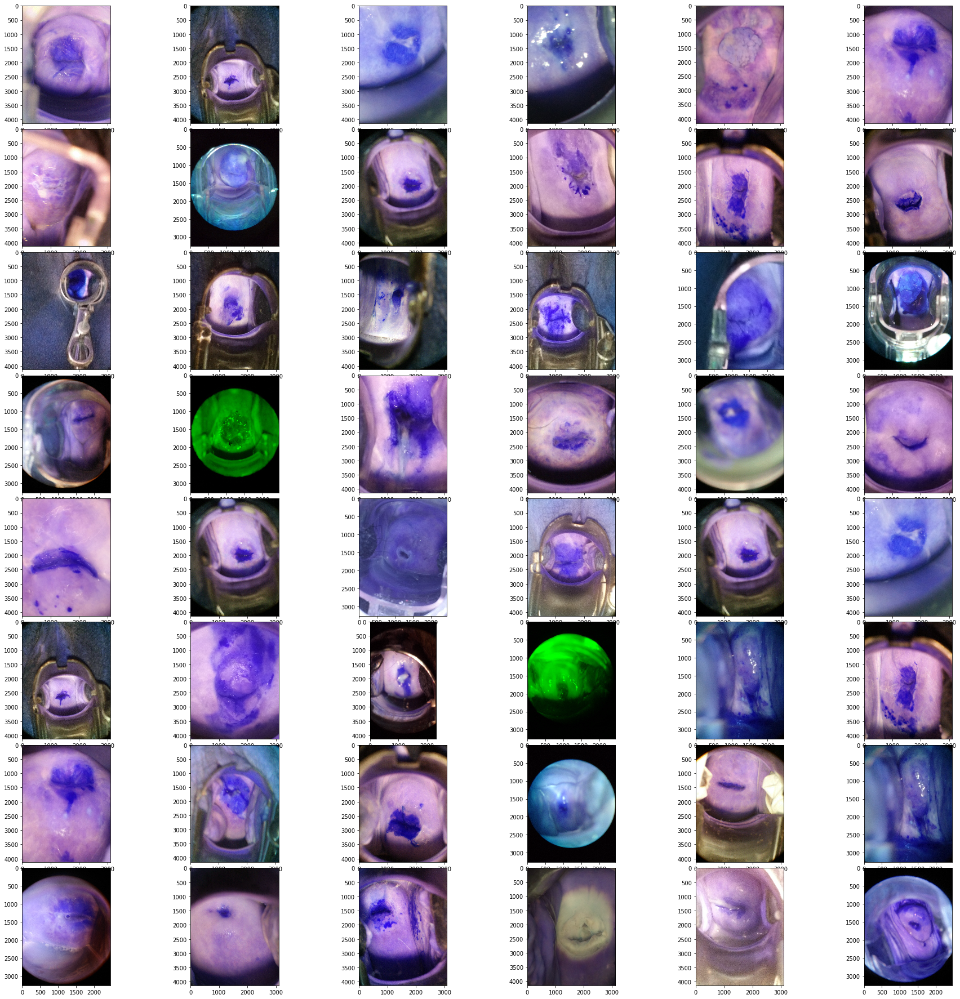

In [27]:
#when using matplotlib inline that means the window size is constrained by the 
# browser window size. If you do a 5x5 gridspec that fills up the browser window
#and if you add more rows after that the individual fig size gets smaller. 
# you can use an external window

display(type1_files)

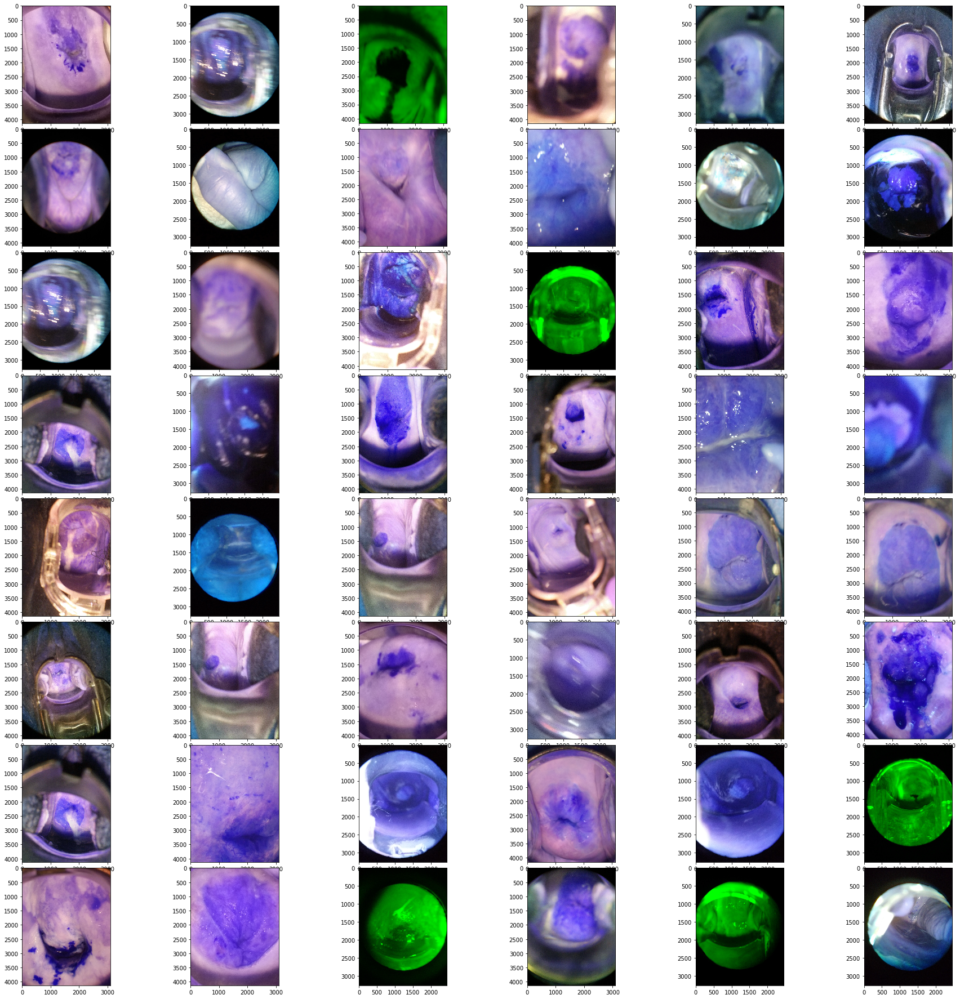

In [30]:
display(type1_addfiles)

In [33]:
path='train/Type_2/'
path_add='additional_Type_2_v2/Type_2/'


type2_files = return_files_from_dir(path,50)
type2_addfiles = return_files_from_dir(path_add,50)
print (len(type2_files))
print (len(type2_addfiles))

numfiles: 781
index: 224 train/Type_2/1358.jpg
index: 363 train/Type_2/276.jpg
index: 139 train/Type_2/1222.jpg
index: 650 train/Type_2/77.jpg
index: 516 train/Type_2/53.jpg
index: 238 train/Type_2/1378.jpg
index: 158 train/Type_2/1255.jpg
index: 235 train/Type_2/1373.jpg
index: 761 train/Type_2/969.jpg
index: 750 train/Type_2/955.jpg
index: 675 train/Type_2/819.jpg
index: 494 train/Type_2/496.jpg
index: 401 train/Type_2/343.jpg
index: 0 train/Type_2/1.jpg
index: 31 train/Type_2/1054.jpg
index: 211 train/Type_2/1338.jpg
index: 776 train/Type_2/990.jpg
index: 332 train/Type_2/213.jpg
index: 39 train/Type_2/107.jpg
index: 697 train/Type_2/857.jpg
index: 338 train/Type_2/225.jpg
index: 30 train/Type_2/1051.jpg
index: 753 train/Type_2/958.jpg
index: 467 train/Type_2/448.jpg
index: 247 train/Type_2/1392.jpg
index: 699 train/Type_2/859.jpg
index: 275 train/Type_2/1446.jpg
index: 237 train/Type_2/1377.jpg
index: 101 train/Type_2/1171.jpg
index: 81 train/Type_2/1142.jpg
index: 306 train/Type_2

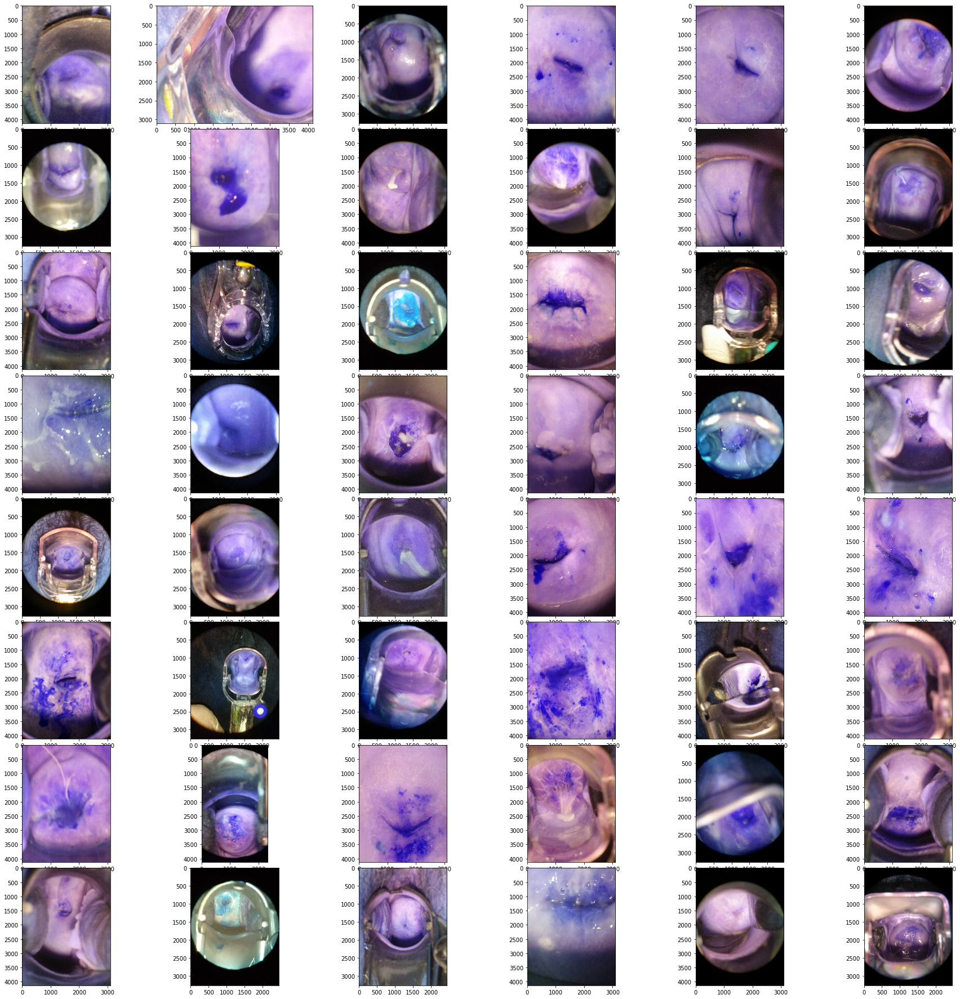

In [34]:
display(type2_files)

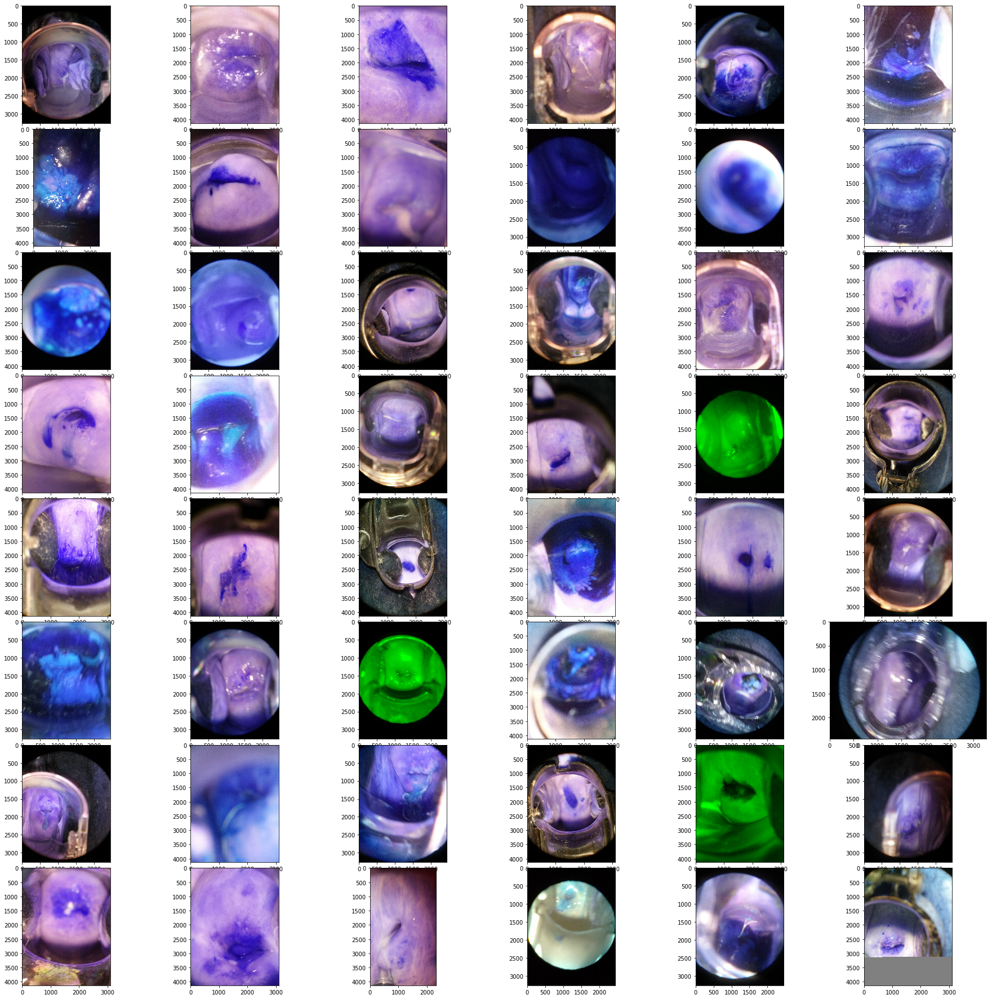

In [35]:
display(type2_addfiles)

In [36]:
path='train/Type_3/'
path_add='additional_Type_3_v2/Type_3/'


type3_files = return_files_from_dir(path,50)
type3_addfiles = return_files_from_dir(path_add,50)
print (len(type3_files))
print (len(type3_addfiles))

numfiles: 450
index: 421 train/Type_3/909.jpg
index: 328 train/Type_3/661.jpg
index: 132 train/Type_3/1417.jpg
index: 56 train/Type_3/1164.jpg
index: 155 train/Type_3/150.jpg
index: 63 train/Type_3/1183.jpg
index: 381 train/Type_3/803.jpg
index: 62 train/Type_3/1182.jpg
index: 18 train/Type_3/1053.jpg
index: 207 train/Type_3/286.jpg
index: 427 train/Type_3/927.jpg
index: 77 train/Type_3/125.jpg
index: 185 train/Type_3/222.jpg
index: 105 train/Type_3/1347.jpg
index: 340 train/Type_3/694.jpg
index: 103 train/Type_3/1335.jpg
index: 360 train/Type_3/747.jpg
index: 221 train/Type_3/321.jpg
index: 299 train/Type_3/58.jpg
index: 332 train/Type_3/672.jpg
index: 446 train/Type_3/986.jpg
index: 155 train/Type_3/150.jpg
index: 424 train/Type_3/916.jpg
index: 111 train/Type_3/1364.jpg
index: 128 train/Type_3/1409.jpg
index: 235 train/Type_3/355.jpg
index: 396 train/Type_3/839.jpg
index: 77 train/Type_3/125.jpg
index: 310 train/Type_3/61.jpg
index: 209 train/Type_3/289.jpg
index: 270 train/Type_3/4

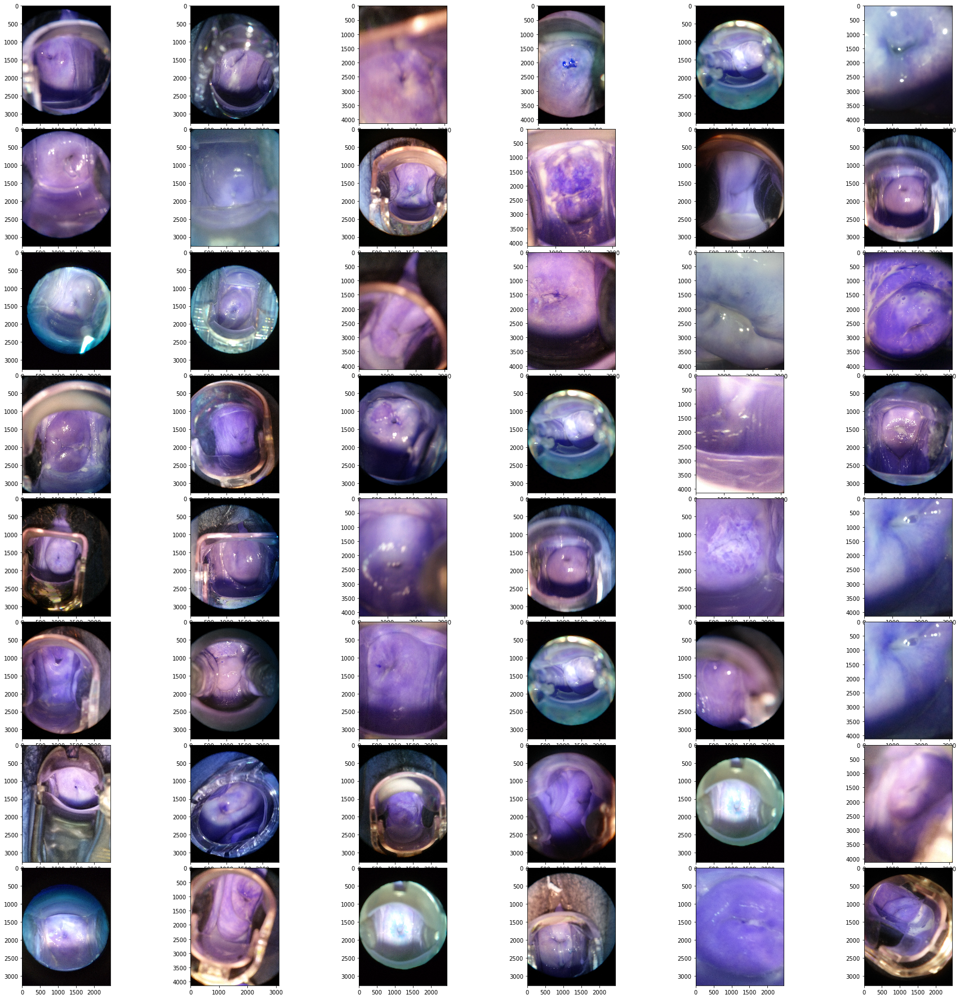

In [37]:
display(type3_files)

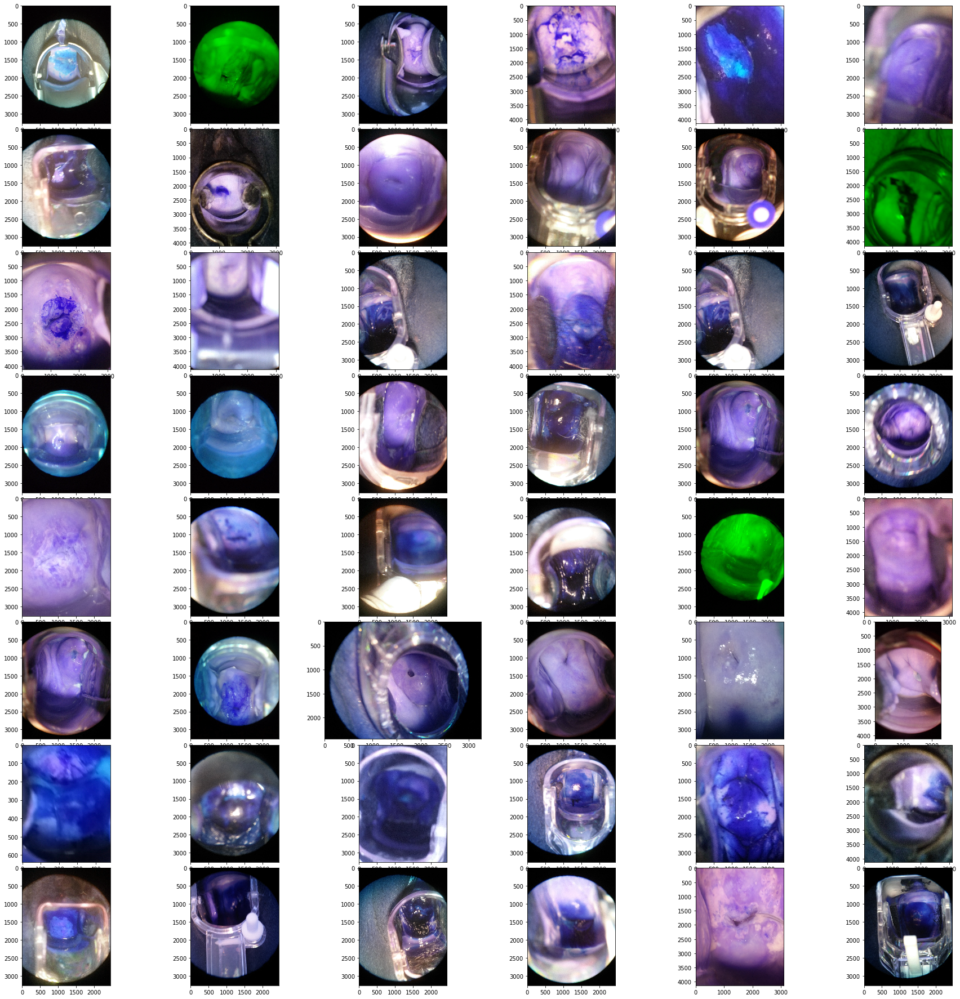

In [40]:
display(type3_addfiles)